## References

https://www.dataquest.io/blog/python-json-tutorial/
https://pythonspot.com/matplotlib-pie-chart/

## Getting a general idea about the json files and their format

In [1]:
%%bash
head 'data/mpd.slice.1000-1999.json'

head: cannot open 'data/mpd.slice.1000-1999.json' for reading: No such file or directory


CalledProcessError: Command 'b"head 'data/mpd.slice.1000-1999.json'\n\n"' returned non-zero exit status 1.

It is a well-formated file with info being the first key, which in itself is another dictionary. The next key is playlists which seems to be an array of dictionaries. Each of this sub-dictionary represents a track from that playlist.

In [3]:
%%bash

grep -E '^ {4}"' 'mpd.v1/data/mpd.slice.4000-4999.json'

    "info": {
    "playlists": [


The above command prints the lines that have 4 leading spaces. This denotes the top most level keys in our dictionary. In our dataset, these keys are 'info' and 'playlists'. Thus, our dictionary contains two main keys: 'info' and 'playlists' which then might be dictionaries in themselves.

In [4]:
%%bash

grep -E '^ {4,16}"' 'mpd.v1/data/mpd.slice.4000-4999.json'

    "info": {
        "generated_on": "2017-12-03 08:41:42.057563", 
        "slice": "4000-4999", 
        "version": "v1"
    "playlists": [
            "name": "skate", 
            "collaborative": "true", 
            "pid": 4000, 
            "modified_at": 1432252800, 
            "num_tracks": 70, 
            "num_albums": 62, 
            "num_followers": 1, 
            "tracks": [
            "num_edits": 55, 
            "duration_ms": 16539160, 
            "num_artists": 53
            "name": "Work out", 
            "collaborative": "false", 
            "pid": 4001, 
            "modified_at": 1493510400, 
            "num_tracks": 12, 
            "num_albums": 11, 
            "num_followers": 1, 
            "tracks": [
            "num_edits": 9, 
            "duration_ms": 3053039, 
            "num_artists": 10
            "name": "Study", 
            "collaborative": "false", 
            "pid": 4002, 
            "modified_at": 1462665600, 
            "num_t

From the above command we can get to know the dictionary structure in much more detail. The top-level keys are 'info' and 'playlists' as discussed earlier. The 'playlists' is a dictionary in itself and it contains the keys: 'name', 'collaborative', 'pid', 'modified_at', 'num_tracks', 'num_albums', 'num_followers', 'tracks', 'num_edits', duration_ms' and 'num_artists'. It thus contains details about that particular playlist. Among these keys, 'tracks' is an array of dictionaries and we get to know about that from the square bracket adjacent to it. It contains all the tracks in the playlist and its metadata.

In [2]:
import ijson

filename = "mpd.v1/data/mpd.slice.4000-4999.json"
with open(filename, 'r') as f:
    objects = ijson.items(f, 'playlists.item')
    columns = list(objects)

print(columns[0])

{'name': 'skate', 'collaborative': 'true', 'pid': 4000, 'modified_at': 1432252800, 'num_tracks': 70, 'num_albums': 62, 'num_followers': 1, 'tracks': [{'pos': 0, 'artist_name': 'Ty Segall', 'track_uri': 'spotify:track:53yXbISmPFewWiFP2kgal8', 'artist_uri': 'spotify:artist:58XGUNsRNu3cVOIOYk5chx', 'track_name': 'Circles', 'album_uri': 'spotify:album:5bXUYhd6yvmry49a8WpEqS', 'duration_ms': 186176, 'album_name': 'Mr. Face'}, {'pos': 1, 'artist_name': 'Creedence Clearwater Revival', 'track_uri': 'spotify:track:47atuTch0AN7NvP9vp42a5', 'artist_uri': 'spotify:artist:3IYUhFvPQItj6xySrBmZkd', 'track_name': 'Ramble Tamble', 'album_uri': 'spotify:album:4GLxEXWI3JiRKp6H7bfTIK', 'duration_ms': 431226, 'album_name': "Cosmo's Factory"}, {'pos': 2, 'artist_name': 'Fugazi', 'track_uri': 'spotify:track:7uzeJ1HasqTqqB2anNRFCs', 'artist_uri': 'spotify:artist:62sC6lUEWRjbFqXpMmOk4G', 'track_name': 'Brendan 1', 'album_uri': 'spotify:album:3ZnF1cPxlqB48RyLiecDnv', 'duration_ms': 152493, 'album_name': 'Repeat

Above, we can see a sample of the 'playlists' key. It is a dictionary and contains keys like 'name', 'collaborative', etc. as discussed earlier. Also, we can see the keys the 'tracks' sub-dictionary contains. It contains the track's details through keys such as pos, artist name, track uri and many more.

In [5]:
column_names = [col["tracks"] for col in columns]
column_names

[[{'pos': 0,
   'artist_name': 'Ty Segall',
   'track_uri': 'spotify:track:53yXbISmPFewWiFP2kgal8',
   'artist_uri': 'spotify:artist:58XGUNsRNu3cVOIOYk5chx',
   'track_name': 'Circles',
   'album_uri': 'spotify:album:5bXUYhd6yvmry49a8WpEqS',
   'duration_ms': 186176,
   'album_name': 'Mr. Face'},
  {'pos': 1,
   'artist_name': 'Creedence Clearwater Revival',
   'track_uri': 'spotify:track:47atuTch0AN7NvP9vp42a5',
   'artist_uri': 'spotify:artist:3IYUhFvPQItj6xySrBmZkd',
   'track_name': 'Ramble Tamble',
   'album_uri': 'spotify:album:4GLxEXWI3JiRKp6H7bfTIK',
   'duration_ms': 431226,
   'album_name': "Cosmo's Factory"},
  {'pos': 2,
   'artist_name': 'Fugazi',
   'track_uri': 'spotify:track:7uzeJ1HasqTqqB2anNRFCs',
   'artist_uri': 'spotify:artist:62sC6lUEWRjbFqXpMmOk4G',
   'track_name': 'Brendan 1',
   'album_uri': 'spotify:album:3ZnF1cPxlqB48RyLiecDnv',
   'duration_ms': 152493,
   'album_name': 'Repeater'},
  {'pos': 3,
   'artist_name': 'Leonard Cohen',
   'track_uri': 'spotify:tr

From the above code, we can see the tracks dictionary in a more focused way. The keys are: pos, artist name, track uri, artist uri, track name, album uri, duration in ms and album name.

## Diving into the data

In [3]:
# Reading csv data into the pandas dataframe
import pandas as pd
df = pd.DataFrame(columns)

In [39]:
# A sneekpeak into the 'playlists' data
df.head()

,collaborative,description,duration_ms,modified_at,name,num_albums,num_artists,num_edits,num_followers,num_tracks,pid,tracks
0,true,NaN,16539160,1432252800,skate,62,53,55,1,70,4000,"[{'pos': 0, 'artist_name': 'Ty Segall', 'track..."
1,false,NaN,3053039,1493510400,Work out,11,10,9,1,12,4001,"[{'pos': 0, 'artist_name': 'Eminem', 'track_ur..."
2,false,NaN,4419474,1462665600,Study,14,13,9,2,19,4002,"[{'pos': 0, 'artist_name': 'Old Dominion', 'tr..."
3,false,NaN,23594821,1493424000,HOLA,89,68,22,2,104,4003,"[{'pos': 0, 'artist_name': 'Reggaeton Latino',..."
4,false,NaN,30240074,1508889600,House,70,47,30,2,79,4004,"[{'pos': 0, 'artist_name': 'Ben Watt', 'track_..."


#### The 'number of albums' characteristic of each playlist 

In [42]:
# Summary Statistics for 'num_albums'

print("Summary Statistics for number of albums\n")

# Using in-built describe method of pandas that calculate a summary of given statistics
describe = df['num_albums'].describe()
print(str(describe)+'\n')

# Using functions 'var' and 'ptp' to calculate variance and range that the 'decsribe' function did not give us
print('Variance\t' + str(df['num_albums'].var()))
print('Range\t\t' + str(df['num_albums'].ptp()))

Summary Statistics for number of albums

count    1000.000000
mean       51.270000
std        39.539632
min         3.000000
25%        20.000000
50%        41.000000
75%        70.000000
max       220.000000
Name: num_albums, dtype: float64

Variance	1563.3824824824826
Range		217


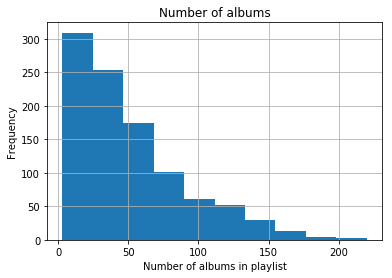

In [46]:
NAlbumsHist = df['num_albums'].hist()
xlabel = NAlbumsHist.set_xlabel("Number of albums in playlist")
ylabel = NAlbumsHist.set_ylabel("Frequency")
title = NAlbumsHist.set_title("Number of albums")

#### The 'number of tracks' characteristic of each playlist

In [45]:
# Summary Statistics for 'num_tracks'

print("Summary Statistics for number of tracks\n")

# Using in-built describe method of pandas that calculate a summary of given statistics
describe = df['num_tracks'].describe()
print(str(describe)+'\n')

# Using functions 'var' and 'ptp' to calculate variance and range that the 'decsribe' function did not give us
print('Variance\t' + str(df['num_tracks'].var()))
print('Range\t\t' + str(df['num_tracks'].ptp()))

Summary Statistics for number of tracks

count    1000.000000
mean       68.101000
std        53.532612
min         5.000000
25%        26.000000
50%        52.000000
75%        95.000000
max       246.000000
Name: num_tracks, dtype: float64

Variance	2865.740539539543
Range		241


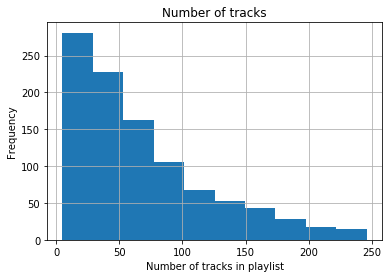

In [47]:
NTracksHist = df['num_tracks'].hist()
xlabel = NTracksHist.set_xlabel("Number of tracks in playlist")
ylabel = NTracksHist.set_ylabel("Frequency")
title = NTracksHist.set_title("Number of tracks")

#### The 'duration in ms' characteristic of each playlist

In [8]:
# Summary Statistics for 'duration'

print("Summary Statistics for duration\n")

# Using in-built describe method of pandas that calculate a summary of given statistics
describe = df['duration_ms'].describe()
print(str(describe)+'\n')

# Using functions 'var' and 'ptp' to calculate variance and range that the 'decsribe' function did not give us
print('Variance\t' + str(df['duration_ms'].var()))
print('Range\t\t' + str(df['duration_ms'].ptp()))

Summary Statistics for duration

count    1.000000e+03
mean     1.604941e+07
std      1.280911e+07
min      1.044377e+06
25%      6.118938e+06
50%      1.228655e+07
75%      2.234913e+07
max      8.309966e+07
Name: duration_ms, dtype: float64

Variance	164073286096730.56
Range		82055288


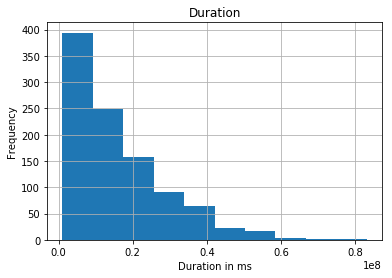

In [10]:
Duration = df['duration_ms'].hist()
xlabel = Duration.set_xlabel("Duration in ms")
ylabel = Duration.set_ylabel("Frequency")
title = Duration.set_title("Duration")

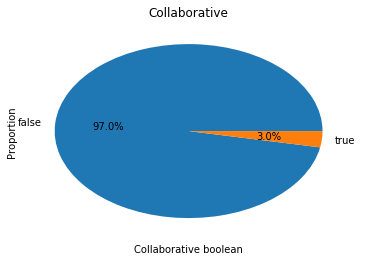

In [5]:
CollaborativeHist = df['collaborative'].value_counts().plot(kind='pie', autopct='%1.1f%%')
xlabel = CollaborativeHist.set_xlabel("Collaborative boolean")
ylabel = CollaborativeHist.set_ylabel("Proportion")
title = CollaborativeHist.set_title("Collaborative")